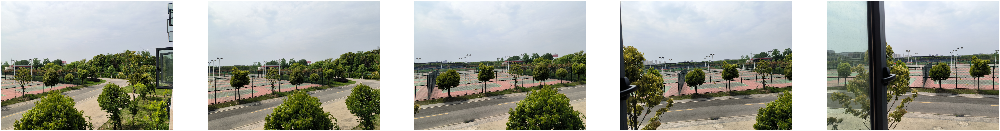

In [15]:
from imutils import paths
import numpy as np
import argparse
import imutils
import cv2
import os
from  matplotlib import pyplot as plt
# construct the argument parser and parse the arguments
# ap = argparse.ArgumentParser()
# ap.add_argument("-i", "--images", type=str, required=True,
#                 help="path to input directory of images to stitch")
# ap.add_argument("-o", "--output", type=str, required=True,
#                 help="path to the output image")
# args = vars(ap.parse_args())


work_path = os.getcwd()

i = 6
img_path = f'picture{i}'
out_path = 'output'
out_img = f'output{i}.jpg'
crop = 1
# grab the paths to the input images and initialize our images list

imagePaths = sorted(list(paths.list_images(os.path.join(work_path, img_path))))
images = []

# loop over the image paths, load each one, and add them to our
# images to stich list

for imagePath in imagePaths:
    image = cv2.imread(imagePath)
    
    images.append(image)


plt.figure(figsize=(100,50)) #设置窗口大小
counter = 0
for img in images:
    counter+=1
    # print(img[:-4])
    # img_dir[img[:-4]]=images
    plt.subplot(2, 5, counter)

    plt.imshow(img[:,:,::-1]),plt.axis('off')

plt.show()





[INFO] stitching images...
0
[INFO] cropping...


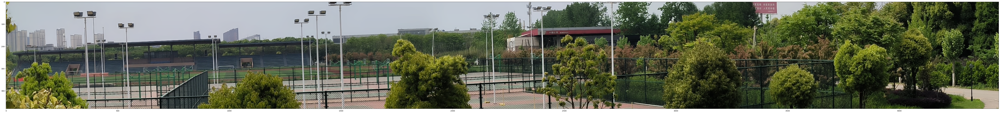

In [16]:

# initialize OpenCV's image sticher object and then perform the image
# stitching
print("[INFO] stitching images...")
stitcher = cv2.createStitcher() if imutils.is_cv3() else cv2.Stitcher_create()

(status, stitched) = stitcher.stitch(images)

# if the status is '0', then OpenCV successfully performed image
# stitching
print(status)
if status == 0:
    # check to see if we supposed to crop out the largest rectangular
    if crop > 0:
        # create a 10 pixel border surrounding the stitched image
        print("[INFO] cropping...")
        stitched = cv2.copyMakeBorder(stitched, 10, 10, 10, 10,
                                      cv2.BORDER_CONSTANT, (0, 0, 0))

        # convert the stitched image to grayscale and threshold it
        # such that all pixels greater than zero are set to 255
        # (foreground) while all others remain 0 (background)
        gray = cv2.cvtColor(stitched, cv2.COLOR_BGR2GRAY)
        thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)[1]

        # find all external contours in the threshold image then find
        # the *largest* contour which will be the contour/outline of
        # the stitched image
        cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL,
                                cv2.CHAIN_APPROX_SIMPLE)
        cnts = imutils.grab_contours(cnts)
        c = max(cnts, key=cv2.contourArea)

        # allocate memory for the mask which will contain the
        # rectangular bounding box of the stitched image region
        mask = np.zeros(thresh.shape, dtype="uint8")
        (x, y, w, h) = cv2.boundingRect(c)
        cv2.rectangle(mask, (x, y), (x + w, y + h), 255, -1)

        # create two copies of the mask: one to serve as our actual
        # minimum rectangular region and another to serve as a counter
        # for how many pixels need to be removed to form the minimum
        # rectangular region
        minRect = mask.copy()
        sub = mask.copy()

        # keep looping until there are no non-zero pixels left in the
        # subtracted image
        while cv2.countNonZero(sub) > 0:
            # erode the minimum rectangular mask and then subtract
            # the thresholded image from the minimum rectangular mask
            # so we can count if there are any non-zero pixels left
            minRect = cv2.erode(minRect, None)
            sub = cv2.subtract(minRect, thresh)

        # find contours in the minimum rectangular mask and then
        # extract the bounding box (x, y)-coordinates
        cnts = cv2.findContours(minRect.copy(), cv2.RETR_EXTERNAL,
                                cv2.CHAIN_APPROX_SIMPLE)
        cnts = imutils.grab_contours(cnts)
        c = max(cnts, key=cv2.contourArea)
        (x, y, w, h) = cv2.boundingRect(c)

        # use the bounding box coordinates to extract the our final
        # stitched image
        stitched = stitched[y:y + h, x:x + w]

    # write the output stitched image to disk
    cv2.imwrite(os.path.join(work_path, out_path, out_img), stitched)

    # display the output stitched image to our screen
    plt.figure(figsize=(100,50)) #设置窗口大小
    im2 = stitched[:,:,::-1] 	# transform image to rgb
    plt.imshow(im2)
    plt.show()
    

# otherwise the stitching failed, likely due to not enough keypoints)
# being detected
else:
    print("[INFO] image stitching failed ({})".format(status))